## Imports

In [23]:
import numpy as np
import pandas as pd
import os
from nltk.translate import bleu
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu
from fastai.vision.all import *
from fastai.text.all import *
from pathlib import Path
import torch
import torch.nn.functional as F
import torch.optim as optim
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader, Dataset
from torch.utils.data.sampler import SubsetRandomSampler
import torchvision
import torchtext
from torchtext.data import get_tokenizer
from collections import Counter
import torchvision.transforms as T
import torchvision.models as models
import matplotlib.pyplot as plt
import PIL
from PIL import Image

In [24]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

## Data Preprocessing

In [25]:
captions_path = "/kaggle/input/flickr8k/captions.txt"
images_path = "/kaggle/input/flickr8k/Images"

df = pd.read_csv(captions_path)
print(f"Len captions: {len(df)}")
df.head()

Len captions: 40455


,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set of stairs in an entry way .
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playhouse .
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a wooden cabin .


In [26]:
tokenizer = get_tokenizer("basic_english")
token_counter = Counter()

**Text Data**

In [27]:
class TextVocab:
    def __init__(self):
        self.id_to_token = {0: "<PAD>", 1: "<start>", 2: "<end>", 3: "<UNK>"}
        self.token_to_id = {token:id for id, token in self.id_to_token.items()}
        self.min_freq = 1
        self.tokenizer = get_tokenizer("basic_english")
        self.token_counter = Counter()

    def __len__(self):
        return len(self.id_to_token)

    def numericalize(self, text):
        tokens_list = self.tokenizer(text)
        numericalized = []
        for token in tokens_list:
            if token in self.token_to_id.keys():
                numericalized.append(self.token_to_id[token])
            else:
                numericalized.append(self.token_to_id["<UNK>"])
        return numericalized

    def build_vocab(self, sentence_list):
        word_count = 4
        for sentence in sentence_list:
            tokens = self.tokenizer(sentence)
            token_counter.update(tokens)
            for token in tokens:
                if token_counter[token] >= self.min_freq and token not in self.token_to_id.keys():
                    self.token_to_id[token] = word_count
                    self.id_to_token[word_count] = token
                    word_count += 1

**Image Data**

In [28]:
# define the transforms
inception_Transform = T.Compose([
    T.Resize(299),
    T.CenterCrop(299),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

### Custom Dataset

In [29]:
class Flick8kDataset(Dataset):
    def __init__(self, image_dir, captions_file, transform=None, min_freq=1):
        self.image_dir = image_dir
        self.df = pd.read_csv(captions_file)
        self.transform = transform
        self.img_ids = self.df["image"]
        self.sentences = self.df["caption"]
        self.vocab = TextVocab()
        self.vocab.min_freq = min_freq
        self.vocab.build_vocab(self.sentences.tolist())
    def __len__(self):
        return len(self.df)
    def __getitem__(self, idx):
        sentence = self.sentences[idx]
        img_id = self.img_ids[idx]
        img_path = os.path.join(self.image_dir, img_id)
        # Open the image
        img = Image.open(img_path).convert("RGB")
        # Apply transformation on image (resize)
        if self.transform is not None:
            img = self.transform(img)

        # Numericalize the caption
        vec = [self.vocab.token_to_id["<start>"]]  # Tagging
        vec += self.vocab.numericalize(sentence)  # Numericalization
        vec += [self.vocab.token_to_id["<end>"]]  # Tagging

        # Return image tensor, text vector, and image ID
        return img, torch.tensor(vec), img_id

In [30]:
transforms = inception_Transform

In [31]:
transforms

Compose(
    Resize(size=299, interpolation=bilinear, max_size=None, antialias=warn)
    CenterCrop(size=(299, 299))
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)

In [32]:
dataset = Flick8kDataset(
    image_dir = images_path,
    captions_file = captions_path,
    transform = transforms
)

In [33]:
print(dataset.vocab.token_to_id)

{'<PAD>': 0, '<start>': 1, '<end>': 2, '<UNK>': 3, 'a': 4, 'child': 5, 'in': 6, 'pink': 7, 'dress': 8, 'is': 9, 'climbing': 10, 'up': 11, 'set': 12, 'of': 13, 'stairs': 14, 'an': 15, 'entry': 16, 'way': 17, '.': 18, 'girl': 19, 'going': 20, 'into': 21, 'wooden': 22, 'building': 23, 'little': 24, 'playhouse': 25, 'the': 26, 'to': 27, 'her': 28, 'cabin': 29, 'black': 30, 'dog': 31, 'and': 32, 'spotted': 33, 'are': 34, 'fighting': 35, 'tri-colored': 36, 'playing': 37, 'with': 38, 'each': 39, 'other': 40, 'on': 41, 'road': 42, 'white': 43, 'brown': 44, 'spots': 45, 'staring': 46, 'at': 47, 'street': 48, 'two': 49, 'dogs': 50, 'different': 51, 'breeds': 52, 'looking': 53, 'pavement': 54, 'moving': 55, 'toward': 56, 'covered': 57, 'paint': 58, 'sits': 59, 'front': 60, 'painted': 61, 'rainbow': 62, 'hands': 63, 'bowl': 64, 'sitting': 65, 'large': 66, 'small': 67, 'grass': 68, 'plays': 69, 'fingerpaints': 70, 'canvas': 71, 'it': 72, 'there': 73, 'pigtails': 74, 'painting': 75, 'young': 76, 'ou

In [34]:
with open('vocab.pkl', 'wb') as file:
    # A new file will be created
    pickle.dump(dataset.vocab, file)

In [35]:
validation_split = .12
shuffle_dataset = False
random_seed= 42

In [36]:
dataset_size = len(dataset)
indices = list(range(dataset_size))
split = int(np.floor(validation_split * dataset_size))
train_indices, val_indices = indices[split:], indices[:split]
if shuffle_dataset :
    np.random.seed(random_seed)
    np.random.shuffle(train_indices)
    np.random.shuffle(val_indices)

In [83]:
def show_image(img, title=None):
    img = img.cpu().numpy()  # Move tensor to CPU and convert to numpy array
    img[0] *= 0.229
    img[1] *= 0.224
    img[2] *= 0.225
    img[0] += 0.485
    img[1] += 0.456
    img[2] += 0.406
    img = img.transpose((1, 2, 0))
    plt.imshow(img)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

1000268201_693b08cb0e.jpg


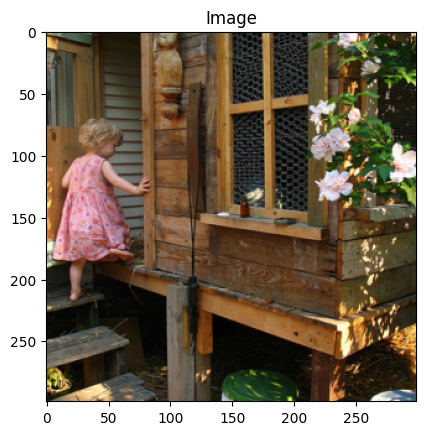

caption:  ['<start>', 'a', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', 'entry', 'way', '.', '<end>']


In [84]:
img, vec, img_id = dataset[0]
print(img_id)
show_image(img, "Image")

caption = [dataset.vocab.id_to_token[token] for token in vec.tolist()]
print("caption: ", caption)

### DataLoaders

**Padding function**

In [39]:
class Collate_fn:
    def __init__(self, pad_value, batch_first=False):
        self.pad_value = pad_value
        self.batch_first = batch_first

    def __call__(self, batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs, dim=0)
        captions = [item[1] for item in batch]

        captions = pad_sequence(captions, batch_first = self.batch_first, padding_value = self.pad_value)

        img_ids = [item[2] for item in batch]

        return imgs, captions, img_ids

In [40]:
batch_size = 64
pad_value = dataset.vocab.token_to_id["<PAD>"]

In [41]:
train_sampler = SubsetRandomSampler(train_indices)
valid_sampler = SubsetRandomSampler(val_indices)

In [42]:
dls = torch.utils.data.DataLoader(dataset,
                                           batch_size=batch_size, shuffle=False,
                                           collate_fn = Collate_fn(pad_value=pad_value, batch_first = True),
                                           sampler=train_sampler)
validation_loader = torch.utils.data.DataLoader(dataset, shuffle=False,
                                                batch_size=batch_size,
                                                collate_fn = Collate_fn(pad_value=pad_value, batch_first = True),
                                                sampler=valid_sampler)

**Check Dataloader**

a woman with blond hair is sitting in a room or hallway with her luggage .


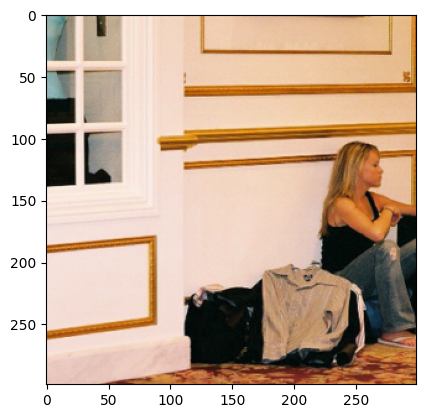

In [43]:
dlsItr = iter(dls)
batch = next(dlsItr)
imgs, captions, img_ids = batch
for i in range(batch_size):
    img, caption = imgs[i], captions[i]
    sentence = [dataset.vocab.id_to_token[token] for token in caption.tolist()]
    end_indx = sentence.index('<end>')
    sentence = sentence[1:end_indx]
    sentence = ' '.join(sentence)
    print(sentence)
    show_image(img)
    plt.show()
    break

## Model Implementation

### Encoder Model

In [44]:
def create_cnn_block(in_channels, out_channels, kernel_size_conv=3, stride_conv=1, padding_conv=1, kernel_size_pool= 2, stride_pool=2, padding_pool=0):
    return nn.Sequential(
      nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size_conv, stride=stride_conv, padding=padding_conv),
      nn.BatchNorm2d(out_channels),
      nn.ReLU(),
      nn.MaxPool2d(kernel_size=kernel_size_pool, stride=stride_pool, padding=padding_pool)
    )
        
class MyCustomCNN(nn.Module):
    def __init__(self):
        super(MyCustomCNN, self).__init__()
        self.layer1 = create_cnn_block(3,64,kernel_size_conv=7, stride_conv=2, padding_conv=3, kernel_size_pool= 3, stride_pool=2, padding_pool=1)
        self.layer2 = create_cnn_block(64,128)
        self.layer3 = create_cnn_block(128,256)
        self.layer4 = create_cnn_block(256,512)
        self.layer5 = create_cnn_block(512,1024)
        self.layer6 = create_cnn_block(1024,2048)

    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        x = self.layer6(x)
        return x

In [45]:
class Encoder(nn.Module):
    def __init__(self):
        super(Encoder, self).__init__()
        self.my_custom_cnn = MyCustomCNN()

    def forward(self, images):
        features = self.my_custom_cnn(images)
        features = features.permute(0, 2, 3, 1)
        features = features.view(features.size(0), -1, features.size(-1))
        return features

## Attention Model

In [46]:
class Attention(nn.Module):

    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        super(Attention, self).__init__()
        self.attention_dim = attention_dim
        self.decoder_att = nn.Linear(decoder_dim, attention_dim)
        self.encoder_att = nn.Linear(encoder_dim, attention_dim)
        self.full_att = nn.Linear(attention_dim, 1)
    def forward(self, features, hidden_states):
        att1 = self.encoder_att(features)
        att2 = self.decoder_att(hidden_states)
        combined_states = torch.tanh(att1 + att2.unsqueeze(1))
        attention_scores = self.full_att(combined_states)
        attention_scores = attention_scores.squeeze(2)
        alpha = F.softmax(attention_scores, dim=1)

        weighted_encoding = features * alpha.unsqueeze(2)   # torch.Size([bs, 64, 1])
        weighted_encoding = weighted_encoding.sum(dim=1)    # sum all weights at dim 1

        return alpha, weighted_encoding


## Decoder Model

In [47]:
class Decoder(nn.Module):
    def __init__(self, embed_sz, vocab_sz, att_dim, enc_dim, dec_dim, drop_prob=0.3):
        super().__init__()
        self.vocab_sz = vocab_sz
        self.att_dim = att_dim
        self.dec_dim = dec_dim
        self.embedding = nn.Embedding(vocab_sz, embed_sz)
        self.attention = Attention(enc_dim, dec_dim, att_dim)
        self.init_h = nn.Linear(enc_dim, dec_dim)
        self.init_c = nn.Linear(enc_dim, dec_dim)
        self.lstm_cell = nn.LSTMCell(embed_sz + enc_dim, dec_dim, bias=True)
        self.f_beta = nn.Linear(dec_dim, enc_dim)
        self.fcn = nn.Linear(dec_dim, vocab_sz)
        self.drop = nn.Dropout(drop_prob)

    def forward(self, features, captions):
        embeds = self.embedding(captions)
        h, c = self.init_hidden_state(features)
        cap_len = len(captions[0]) - 1

        batch_sz = captions.size(0)
        num_features = features.size(1)

        preds = torch.zeros(batch_sz, cap_len, self.vocab_sz).to(device)
        alphas = torch.zeros(batch_sz, cap_len, num_features).to(device)

        for i in range(cap_len):
            alpha, att_weights = self.attention(features, h)
            lstm_input = torch.cat((embeds[:,i], att_weights), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            preds[:, i] = output
            alphas[:, i] = alpha

        return preds, alphas

    def generate_caption(self, features, max_len=20, vocab=None):
        batch_sz = features.size(0)
        h, c = self.init_hidden_state(features)
        alphas = []
        captions = [vocab.token_to_id['<start>']]
        word = torch.tensor(vocab.token_to_id['<start>']).view(1, -1).to(device)
        embeds = self.embedding(word)

        for i in range(max_len):
            alpha, weighted_encoding = self.attention(features, h)
            alphas.append(alpha.cpu().detach().numpy())
            lstm_input = torch.cat((embeds[:, 0], weighted_encoding), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            output = output.view(batch_sz, -1)
            pred_word_idx = output.argmax(dim=1)
            captions.append(pred_word_idx.item())

            if vocab.id_to_token[pred_word_idx.item()] == '<end>':
                break

            embeds = self.embedding(pred_word_idx.unsqueeze(0))

        return [vocab.id_to_token[idx] for idx in captions], alphas

    def init_hidden_state(self, encoder_out):
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)
        c = self.init_c(mean_encoder_out)
        return h, c

## Encoder - decoder


In [48]:
class EncoderDecoder(nn.Module):
    def __init__(self, embed_sz, vocab_sz, att_dim, enc_dim, dec_dim, drop_prob=0.3):
        super().__init__()
        self.encoder = Encoder()
        self.decoder = Decoder(
            embed_sz = embed_sz,
            vocab_sz = vocab_sz,
            att_dim = att_dim,
            enc_dim = enc_dim,
            dec_dim = dec_dim
        )

    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs

## Set the Hyperameters

In [49]:
embed_sz = 300
vocab_sz = len(dataset.vocab)
att_dim = 256
enc_dim = 2048
dec_dim = 512
learning_rate = 3e-4

## Model

In [96]:
# initialize model
model = None
model = EncoderDecoder(
    embed_sz = 300,
    vocab_sz = len(dataset.vocab),
    att_dim = 128,
    enc_dim = 2048,
    dec_dim = 256
)
if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)

In [92]:
criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.token_to_id["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

## Training

In [101]:
epochs = 30
print_each = 100

In [97]:
PATH = '/kaggle/working/CNN_LSTM_attention_20.pth'
if torch.cuda.is_available():
    model.load_state_dict(torch.load(PATH))
else:
    model.load_state_dict(torch.load(PATH, map_location=torch.device('cpu')))
# Use DataParallel if more than 1 GPU is available

print(model)

DataParallel(
  (module): EncoderDecoder(
    (encoder): Encoder(
      (my_custom_cnn): MyCustomCNN(
        (layer1): Sequential(
          (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
          (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        )
        (layer2): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        )
        (layer3): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          

In [ ]:
# # Adjust state_dict keys if needed
# if torch.cuda.device_count() > 1 and not any(k.startswith('module.') for k in state_dict.keys()):
#     new_state_dict = OrderedDict()
#     for k, v in state_dict.items():
#         new_state_dict['module.' + k] = v
#     model.load_state_dict(new_state_dict)
# else:
#     model.load_state_dict(state_dict)

In [98]:
# Move model to the first GPU
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)
print(model)

DataParallel(
  (module): EncoderDecoder(
    (encoder): Encoder(
      (my_custom_cnn): MyCustomCNN(
        (layer1): Sequential(
          (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
          (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        )
        (layer2): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        )
        (layer3): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          

Epoch: 21 loss: 1.67775 ID: 99
<start> two men are playing in a park . <end>


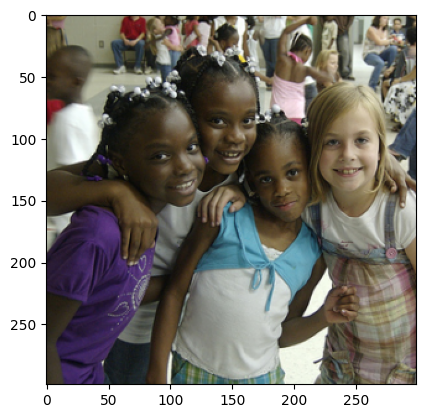

Epoch: 21 loss: 1.73978 ID: 199
<start> a man in a black jacket is standing next to a building . <end>


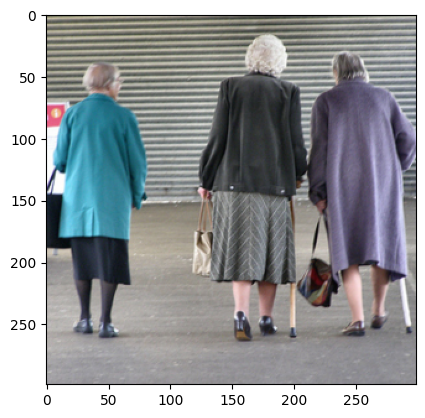

Epoch: 21 loss: 1.72078 ID: 299
<start> a man is standing on a rocky shore . <end>


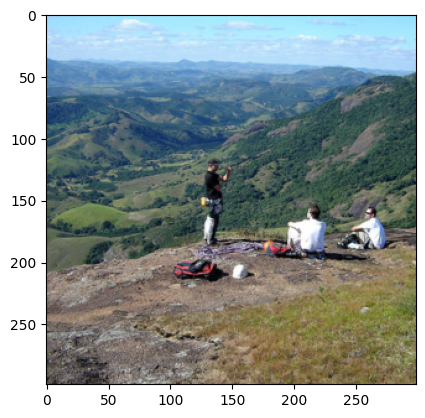

Epoch: 21 loss: 1.76534 ID: 399
<start> a baby with a baby eating . <end>


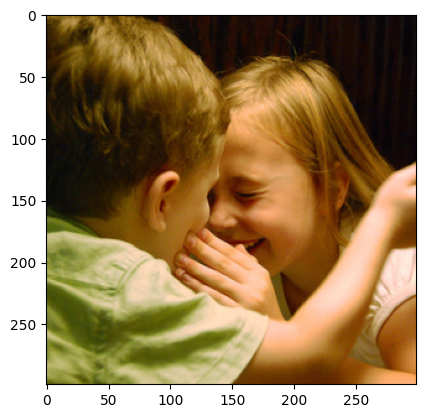

Epoch: 21 loss: 1.70791 ID: 499
<start> a man in a blue shirt is jumping into a large pool . <end>


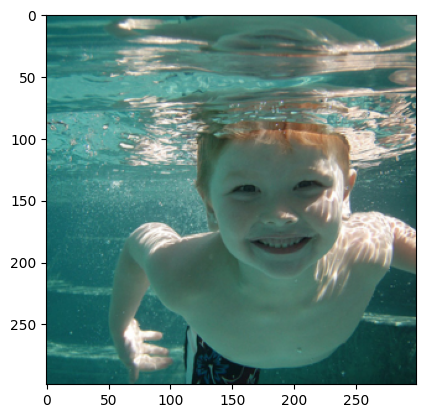

Epoch: 22 loss: 1.73261 ID: 99
<start> a young boy in a red shirt and white shorts is on a red and white , white , and


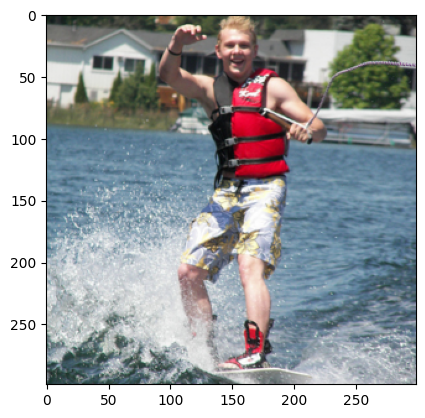

Epoch: 22 loss: 1.72095 ID: 199
<start> a woman in a yellow shirt is running on a field with a blue ball in his mouth . <end>


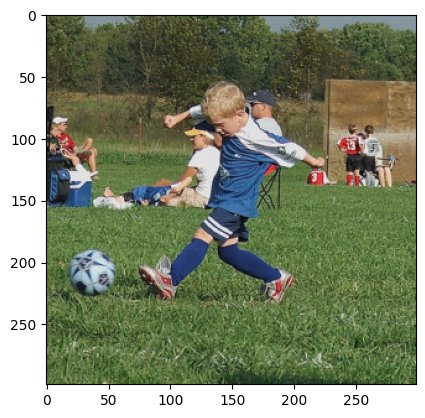

Epoch: 22 loss: 1.68326 ID: 299
<start> a black and white dog jumps over a hurdle . <end>


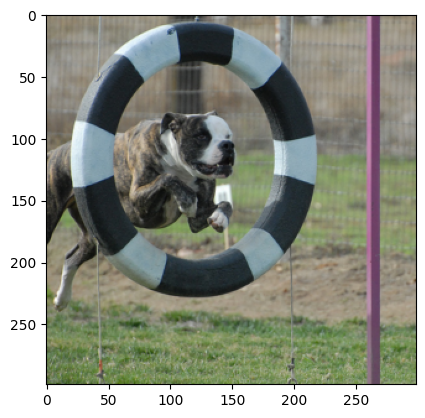

Epoch: 22 loss: 1.83277 ID: 399
<start> a man is jumping off of a cliff into the ocean . <end>


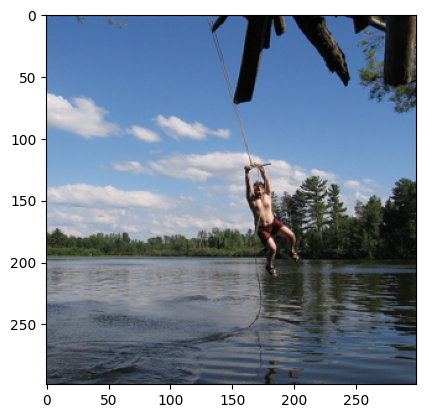

Epoch: 22 loss: 1.74479 ID: 499
<start> a girl in a pink shirt is holding a large bubble . <end>


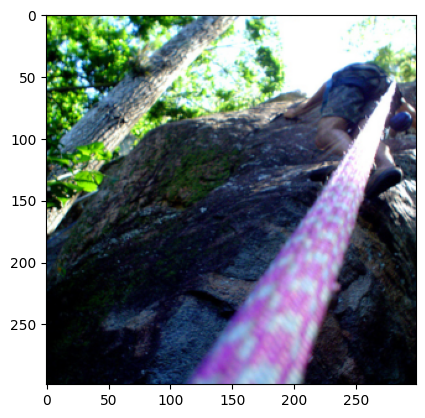

Epoch: 23 loss: 1.70703 ID: 99
<start> a man in a red shirt is standing in front of a large tree . <end>


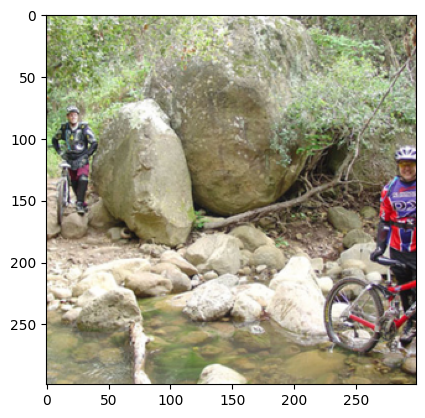

Epoch: 23 loss: 1.75784 ID: 199
<start> a young boy is playing with a large stick . <end>


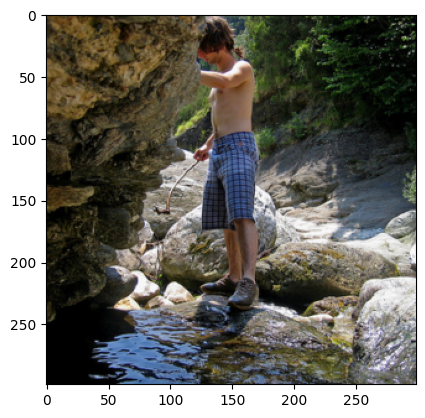

Epoch: 23 loss: 1.64302 ID: 299
<start> a man in a red shirt and hat is holding a red cup . <end>


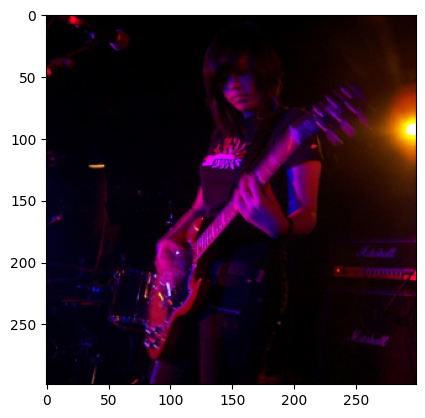

Epoch: 23 loss: 1.52604 ID: 399
<start> a person wearing a helmet riding a bicycle . <end>


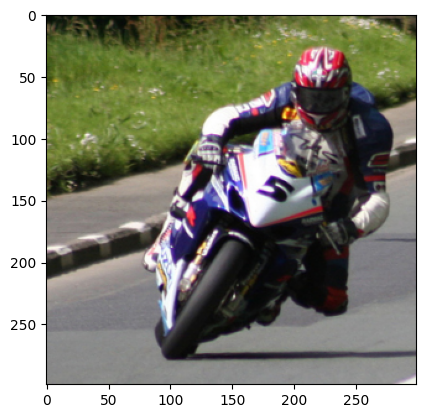

Epoch: 23 loss: 1.63998 ID: 499
<start> a dog is running with a red ball on a grassy field . <end>


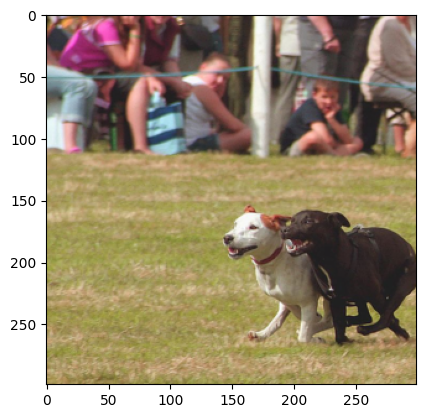

Epoch: 24 loss: 1.75315 ID: 99
<start> two people are walking through the water . <end>


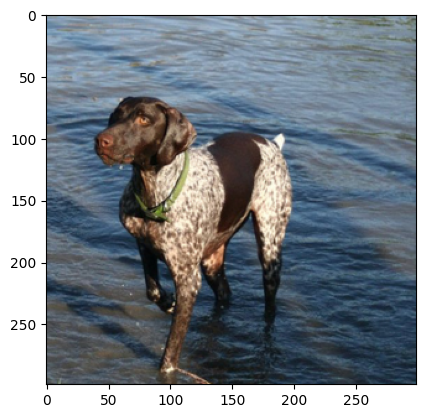

Epoch: 24 loss: 1.73550 ID: 199
<start> a dog is running on the grass with a large stick in the background . <end>


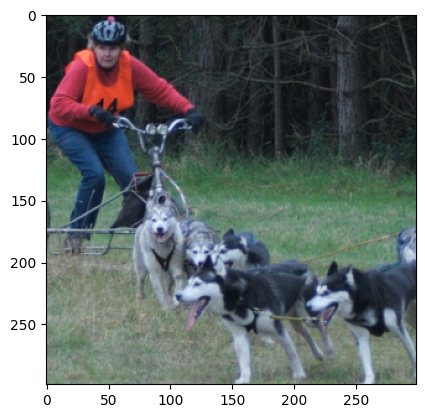

Epoch: 24 loss: 1.66777 ID: 299
<start> a girl in a red shirt is sitting on a red bench . <end>


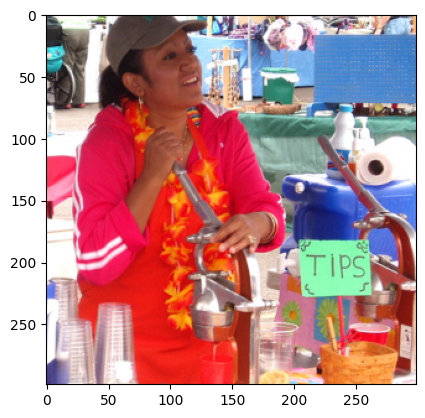

Epoch: 24 loss: 1.70309 ID: 399
<start> a man in a red shirt and a red shirt and a blue shirt and blue jeans and a red


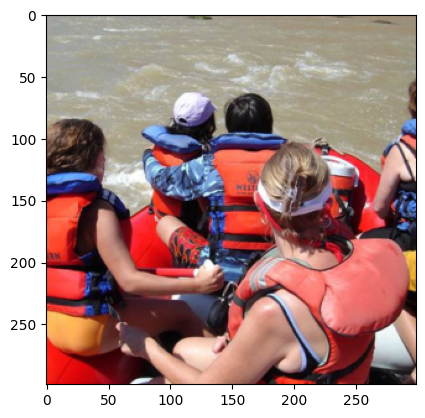

Epoch: 24 loss: 1.71059 ID: 499
<start> a man in a red shirt and white shirt is sitting on a stage . <end>


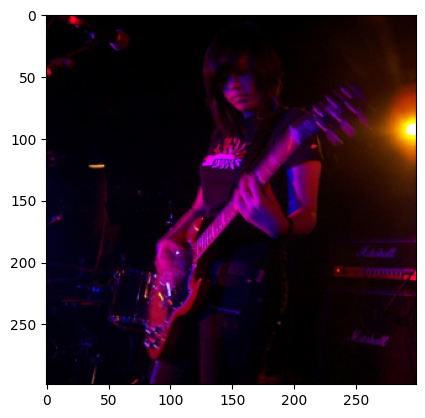

Epoch: 25 loss: 1.72239 ID: 99
<start> a man in a black shirt and a black shirt is holding a drink . <end>


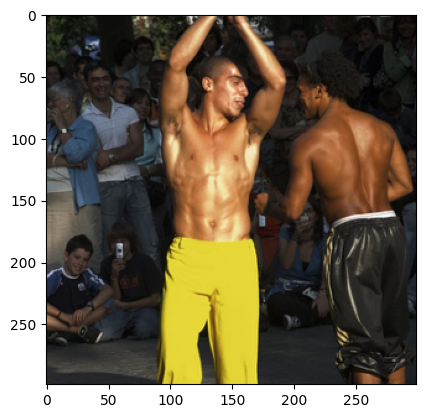

Epoch: 25 loss: 1.66582 ID: 199
<start> a man in a blue shirt is sitting on a bench in front of a large building . <end>


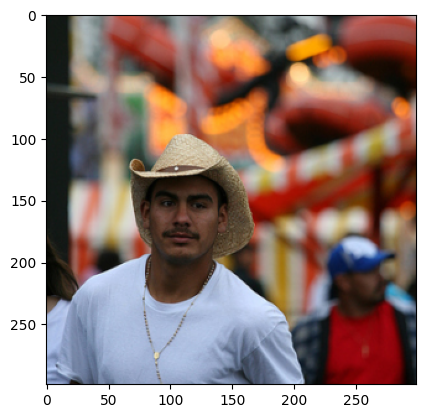

Epoch: 25 loss: 1.81269 ID: 299
<start> a young girl is playing with a large white dog . <end>


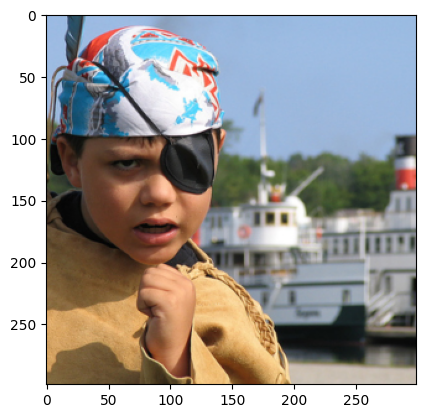

Epoch: 25 loss: 1.68537 ID: 399
<start> a dog is running through a wooded area . <end>


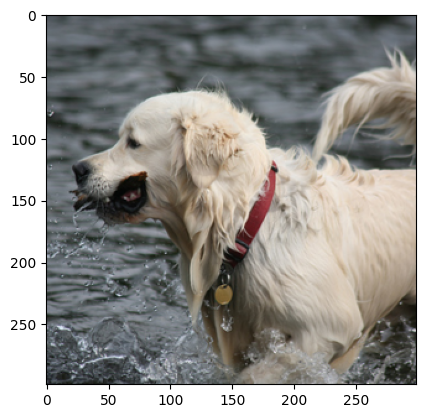

Epoch: 25 loss: 1.74231 ID: 499
<start> a black and white dog is running on the beach . <end>


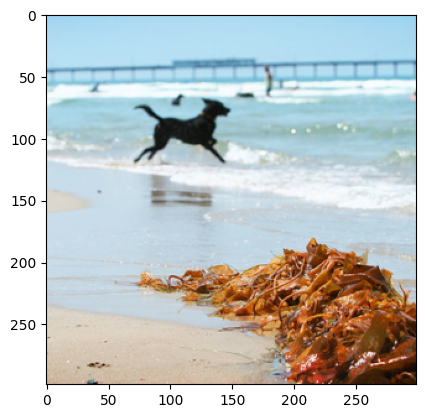

Epoch: 26 loss: 1.76175 ID: 99
<start> a woman in a white shirt and jeans is standing on a sidewalk with a group of people in background


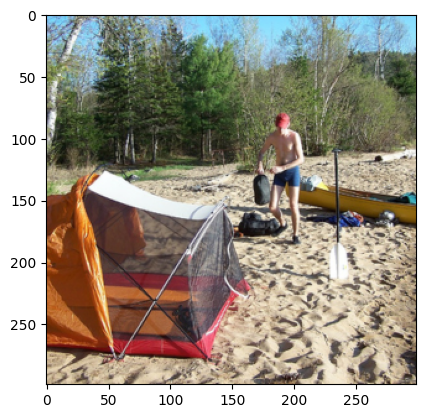

Epoch: 26 loss: 1.64737 ID: 199
<start> a woman in a white shirt and blue jeans is walking through a lake . <end>


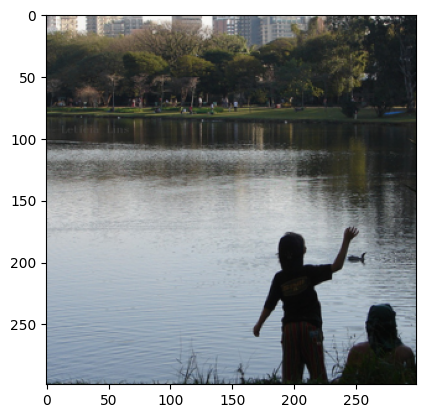

Epoch: 26 loss: 1.60626 ID: 299
<start> a man is splashing in a pool . <end>


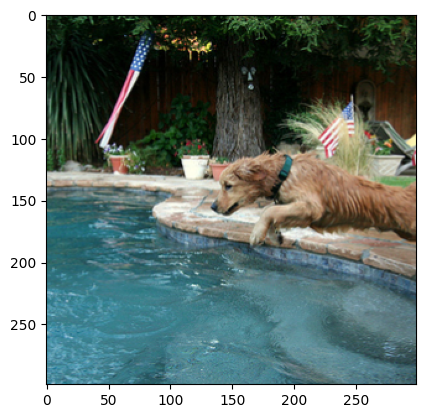

Epoch: 26 loss: 1.65736 ID: 399
<start> a girl in a white shirt is walking through a large pile of wood . <end>


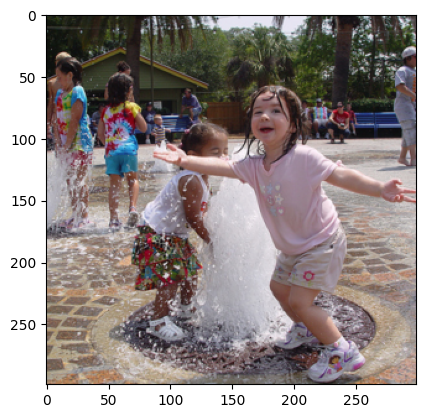

Epoch: 26 loss: 1.75134 ID: 499
<start> a black and white dog is running through the grass . <end>


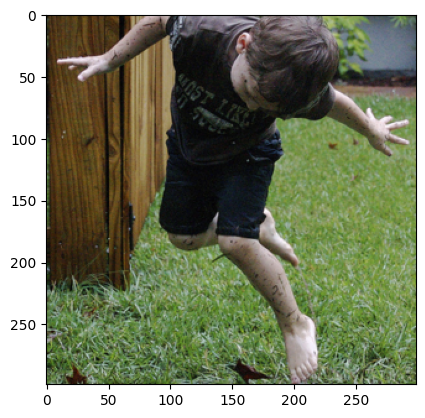

Epoch: 27 loss: 1.62430 ID: 99
<start> a man in a blue shirt is climbing up a steep rock . <end>


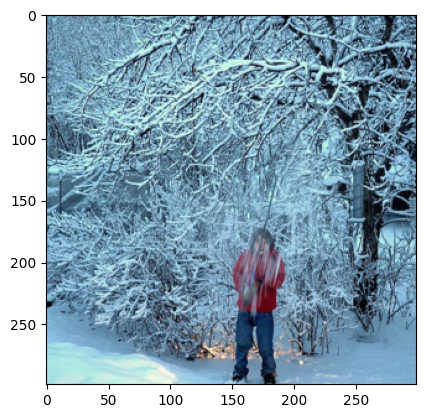

Epoch: 27 loss: 1.81938 ID: 199
<start> two women with a black and white dog . <end>


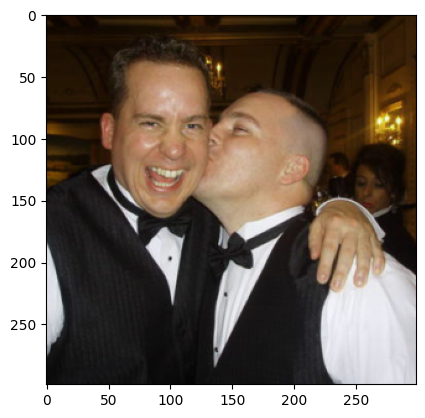

Epoch: 27 loss: 1.77524 ID: 299
<start> a dog runs through the grass . <end>


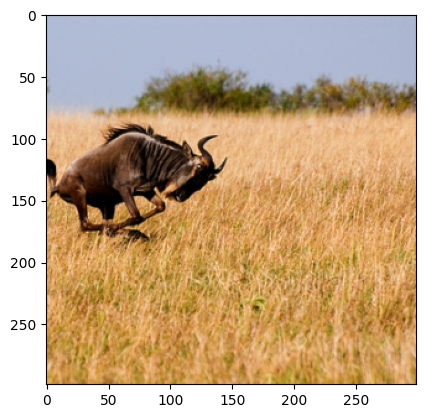

Epoch: 27 loss: 1.64223 ID: 399
<start> a boy in a blue shirt is holding a blue and yellow toy . <end>


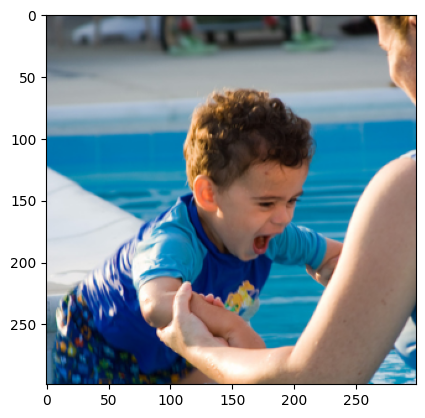

Epoch: 27 loss: 1.74263 ID: 499
<start> a woman is holding a large stick . <end>


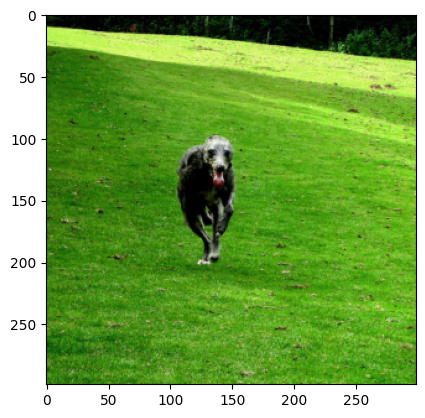

Epoch: 28 loss: 1.60335 ID: 99
<start> a woman in a white shirt is holding a child on a sidewalk . <end>


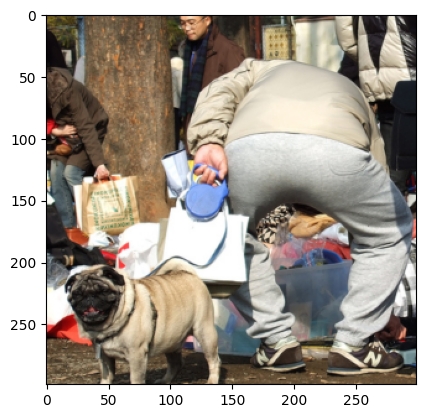

Epoch: 28 loss: 1.63162 ID: 199
<start> a man with a black shirt and brown hair is sitting on a wooden bench . <end>


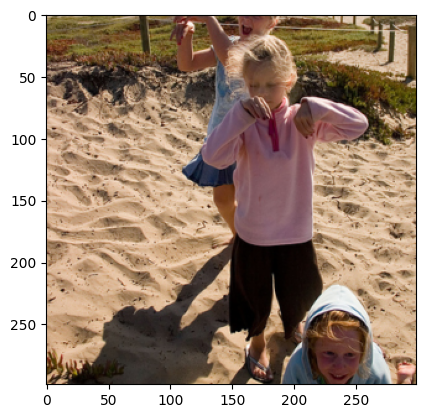

Epoch: 28 loss: 1.87863 ID: 299
<start> a woman in a red shirt is standing in front of a large crowd of a crowd . <end>


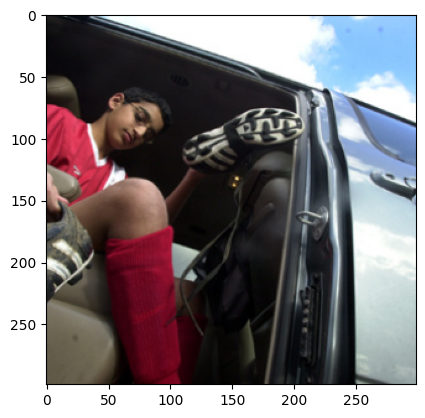

Epoch: 28 loss: 1.66729 ID: 399
<start> a man in a red shirt is sitting in a large crowd of people . <end>


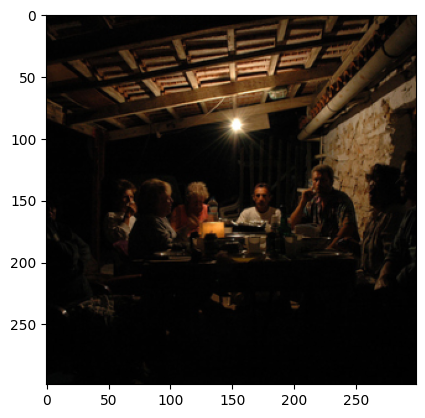

Epoch: 28 loss: 1.72175 ID: 499
<start> a woman in a blue shirt and blue jeans is walking down a street . <end>


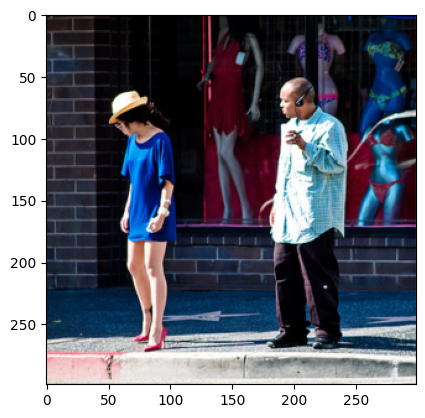

Epoch: 29 loss: 1.76914 ID: 99
<start> a small white dog is running in a field . <end>


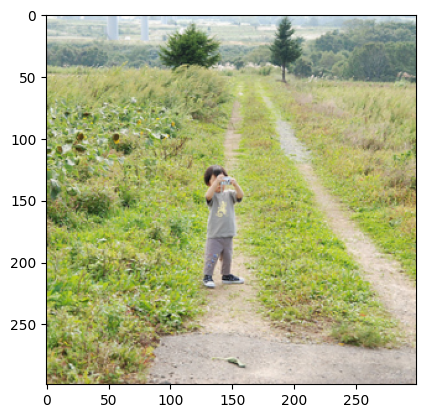

Epoch: 29 loss: 1.74301 ID: 199
<start> a girl in a red shirt and blue jeans is playing with a stick in his mouth . <end>


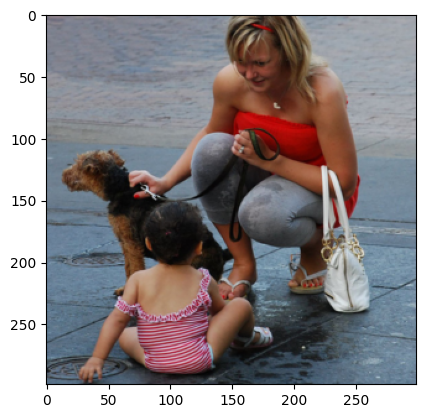

Epoch: 29 loss: 1.69878 ID: 299
<start> a man in a black jacket is standing next to a building . <end>


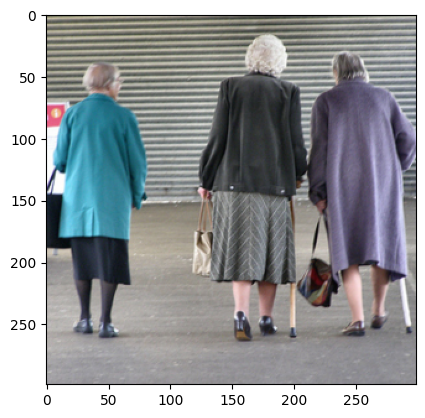

Epoch: 29 loss: 1.69751 ID: 399
<start> a young man is standing on a bench in front of a building . <end>


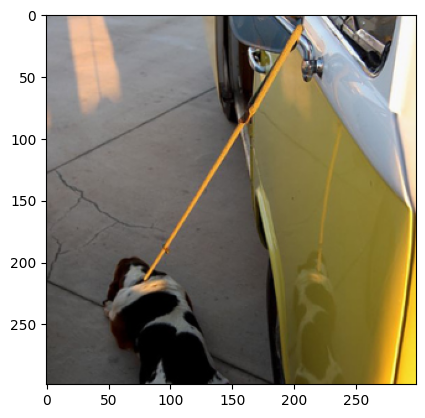

Epoch: 29 loss: 1.67624 ID: 499
<start> a dog is jumping up to the the ocean . <end>


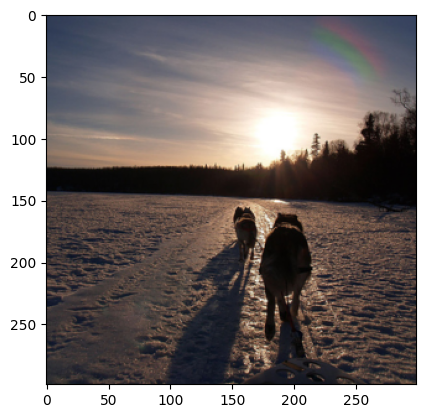

Epoch: 30 loss: 1.69765 ID: 99
<start> two people are standing in a city street . <end>


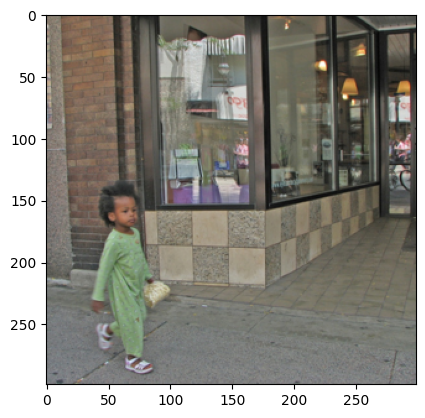

Epoch: 30 loss: 1.46848 ID: 199
<start> a group of people are playing soccer on a field . <end>


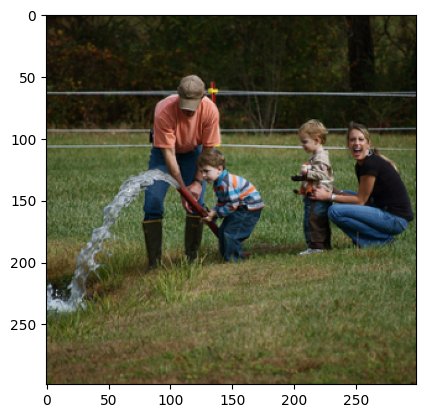

Epoch: 30 loss: 1.81260 ID: 299
<start> a man in a pink shirt is running through a field . <end>


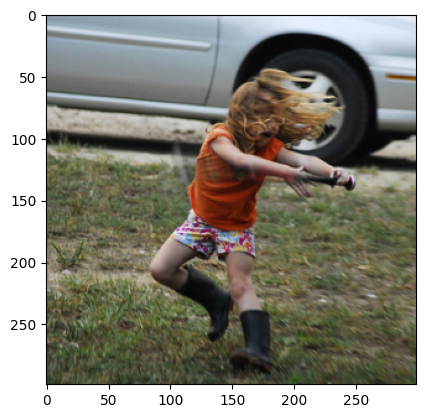

Epoch: 30 loss: 1.81830 ID: 399
<start> a black dog is running through the grass . <end>


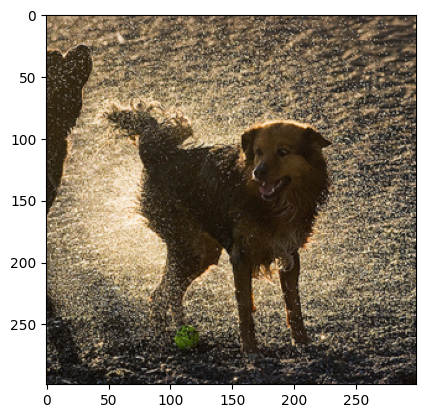

Epoch: 30 loss: 1.69799 ID: 499
<start> a man wearing a red shirt and a blue shirt is holding a paper in his hand . <end>


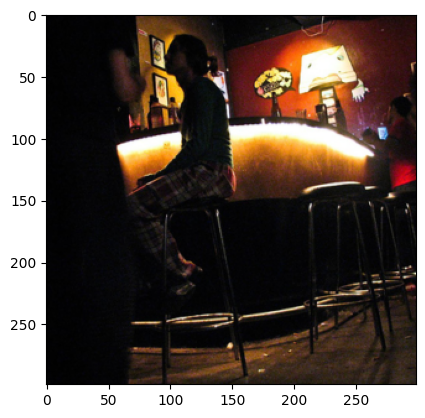

In [102]:
# for epoch in range(21, epochs + 1):
    model.train()
    for idx, (img, captions, img_ids) in enumerate(dls):
        img, captions = img.to(device), captions.to(device)
        optimizer.zero_grad()
        pred_caps, attentions = model(img, captions)
        targets = captions[:, 1:]
        loss = criterion(pred_caps.view(-1, vocab_sz), targets.reshape(-1))
        loss.backward()
        optimizer.step()

        if (idx + 1) % print_each == 0:
            print("Epoch: {} loss: {:.5f} ID: {}".format(epoch, loss.item(), idx))
            model.eval()
            with torch.no_grad():
                itr = iter(validation_loader)
                img, _, _ = next(itr)
                img = img.to(device)
                if isinstance(model, nn.DataParallel):
                    features = model.module.encoder(img[0:1])
                    pred_caps, alphas = model.module.decoder.generate_caption(features, vocab=dataset.vocab)
                else:
                    features = model.encoder(img[0:1])
                    pred_caps, alphas = model.decoder.generate_caption(features, vocab=dataset.vocab)
                caption = ' '.join(pred_caps)
                print(caption)
                show_image(img[0])  # Uncomment and define `show_image` if necessary
            model.train()

#     if epoch % 2 == 0:
    torch.save(model.state_dict(), 'CNN_LSTM_attention_{}.pth'.format(epoch))


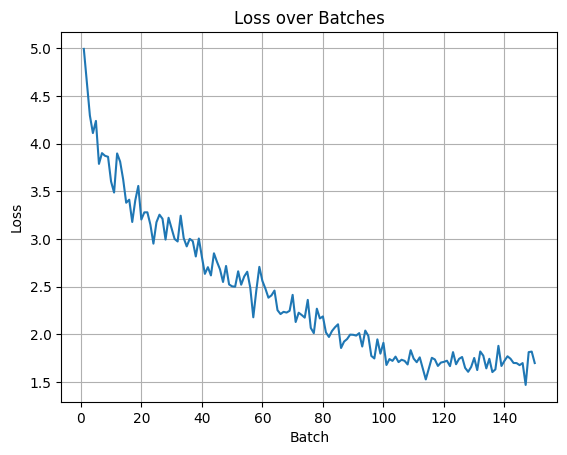

In [105]:
import matplotlib.pyplot as plt

# Read the file
with open('/kaggle/input/loss-of-cnn/loss.txt', 'r') as file:
    lines = file.readlines()

batch = []
loss_values = []

# Parse the data
for line in lines:
    if line.startswith('Epoch'):
        loss = float(line.split(' loss: ')[1].split(' ')[0])
        loss_values.append(loss)

# Generate batch values
batch = range(1, len(loss_values) + 1)

# Plot the line charts
plt.plot(batch, loss_values)
plt.xlabel('Batch')
plt.ylabel('Loss')
plt.title('Loss over Batches')
plt.grid(True)
plt.show()

## Model Testing

In [127]:
PATH = '/kaggle/working/CNN_LSTM_attention_21.pth'

In [128]:
# Load trọng số cho model
model = EncoderDecoder(
    embed_sz=300,
    vocab_sz=len(dataset.vocab),
    att_dim=128,
    enc_dim=2048,
    dec_dim=256
)
if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)
if torch.cuda.is_available():
    model.load_state_dict(torch.load(PATH))
else:
    model.load_state_dict(torch.load(PATH, map_location=torch.device('cpu')))
    
model.to(device)

DataParallel(
  (module): EncoderDecoder(
    (encoder): Encoder(
      (my_custom_cnn): MyCustomCNN(
        (layer1): Sequential(
          (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
          (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        )
        (layer2): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        )
        (layer3): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU()
          

Original Caption: <start> two people wearing yellow jackets cross-country skiing . <end>
Predicted Caption: <start> a man in a black jacket and white hat is standing on a sidewalk with a man in the background


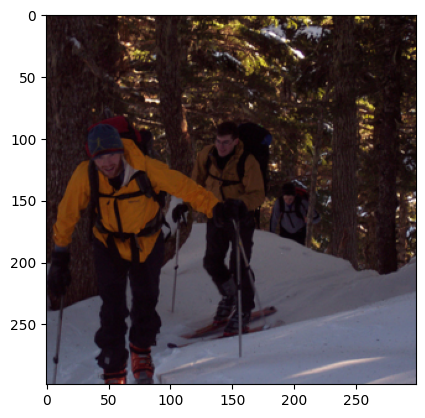

Original Caption: <start> view from the summit <end>
Predicted Caption: <start> a man in a red shirt is standing on a mountain . <end>


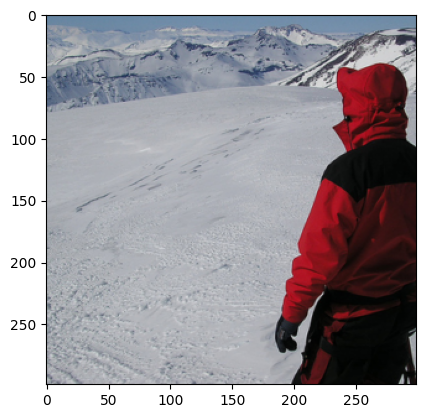

Original Caption: <start> a brown dog playing with a tennis ball <end>
Predicted Caption: <start> a dog is standing in front of a large tree . <end>


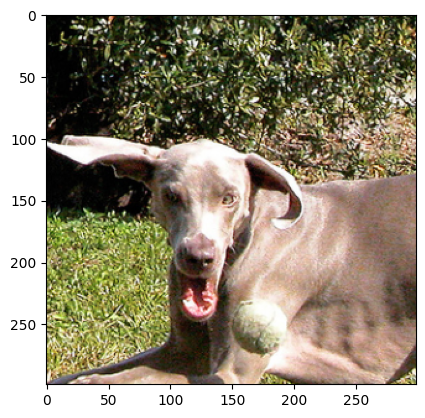

Original Caption: <start> a young girl balances on wooden pylons at the beach . <end>
Predicted Caption: <start> a woman is standing on a rocky hill with a large stick in his mouth . <end>


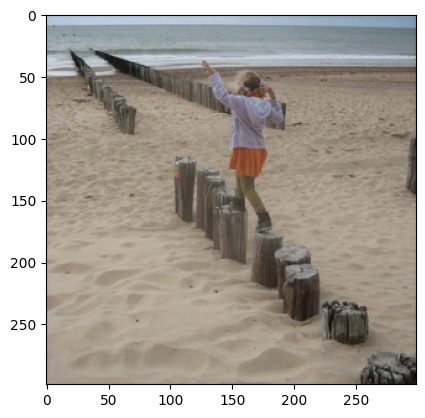

Original Caption: <start> a black and brown dog is playing on the ice at the edge of a lake . <end>
Predicted Caption: <start> a black and white dog is jumping in the air . <end>


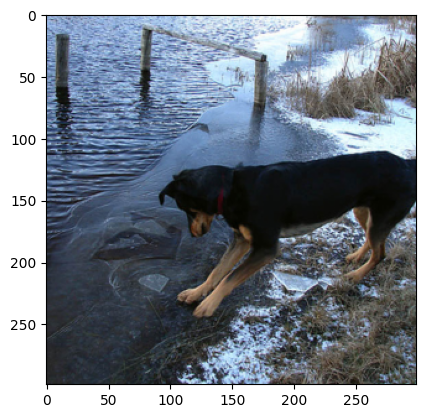

Original Caption: <start> several people sit on a train . <end>
Predicted Caption: <start> two people are sitting at a table with a man in a blue shirt . <end>


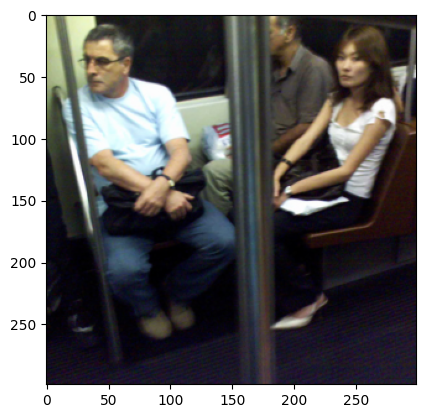

Original Caption: <start> little girl in rural area , carrying bags and stuffed animal . <end>
Predicted Caption: <start> a man in a brown shirt is playing with a soccer ball . <end>


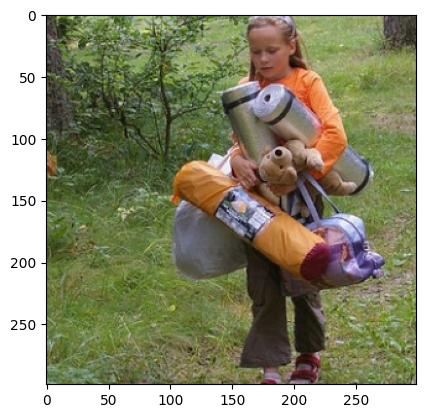

Original Caption: <start> a long-necked bird standing on a rock with waves crashing in the background . <end>
Predicted Caption: <start> a man is standing in front of a large rock . <end>


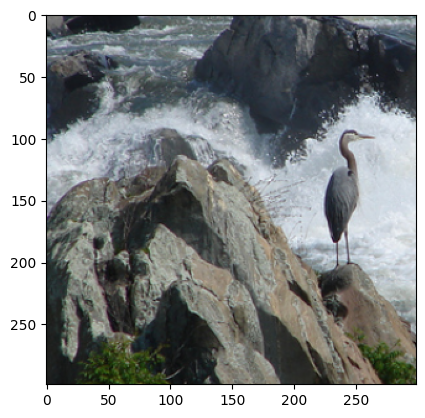

Original Caption: <start> a woman in an orange coat and jeans is squatting on a rock wall while a blonde woman in a red jacket stands next to her on the wall checking her electronic device <end>
Predicted Caption: <start> a group of children playing in a grassy field . <end>


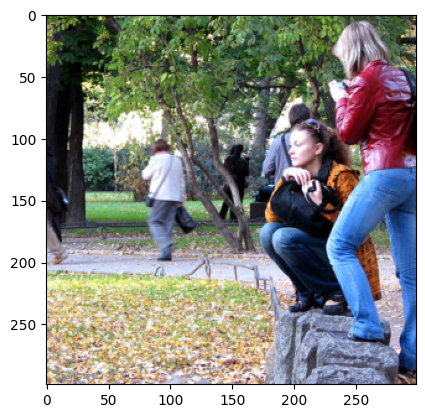

Original Caption: <start> a woman sits on a flower pot at a crowded coffee shop . <end>
Predicted Caption: <start> a man in a white shirt is holding a large stick . <end>


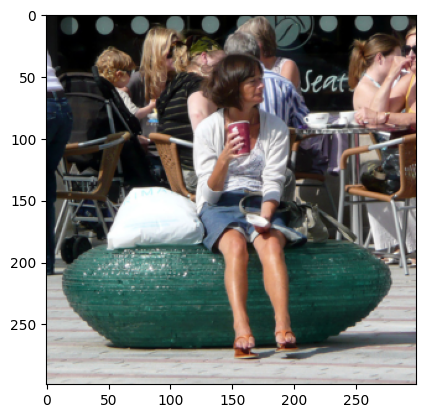

In [130]:
model.eval()
with torch.no_grad():
    itr = iter(validation_loader)
    for i in range(10):
        img, captions, img_ids = next(itr)
        original_caption = captions[:1][0].tolist()
        original_words = [dataset.vocab.id_to_token[idx] for idx in original_caption if idx != 0]
        print("Original Caption:", ' '.join(original_words))
        
        # Accessing the encoder and decoder correctly if the model is wrapped in DataParallel
        if isinstance(model, nn.DataParallel):
            features = model.module.encoder(img[:1].to(device))
            predicted_caption, alphas = model.module.decoder.generate_caption(features, vocab=dataset.vocab)
        else:
            features = model.encoder(img[:1].to(device))
            predicted_caption, alphas = model.decoder.generate_caption(features, vocab=dataset.vocab)
        
        predicted_words = ' '.join(predicted_caption)
        print("Predicted Caption:", predicted_words)
        show_image(img[0])


**BLEU Score Prediction**

In [131]:
class DataDict:
    def __init__(self):
        self.dict = {}
    def add(self, key, value):
        if key in self.dict:
            self.dict[key].append(value)
        else:
          self.dict[key] = [value]

descriptors = DataDict()

for i in range(len(df)):
    img_id = df.iloc[i, 0]
    sentence = ("<start> " + df.iloc[i, 1] + " <end>").split()
    descriptors.add(img_id, sentence)

first_element_value = next(iter(descriptors.dict.values()))
print(first_element_value)


[['<start>', 'A', 'child', 'in', 'a', 'pink', 'dress', 'is', 'climbing', 'up', 'a', 'set', 'of', 'stairs', 'in', 'an', 'entry', 'way', '.', '<end>'], ['<start>', 'A', 'girl', 'going', 'into', 'a', 'wooden', 'building', '.', '<end>'], ['<start>', 'A', 'little', 'girl', 'climbing', 'into', 'a', 'wooden', 'playhouse', '.', '<end>'], ['<start>', 'A', 'little', 'girl', 'climbing', 'the', 'stairs', 'to', 'her', 'playhouse', '.', '<end>'], ['<start>', 'A', 'little', 'girl', 'in', 'a', 'pink', 'dress', 'going', 'into', 'a', 'wooden', 'cabin', '.', '<end>']]


In [134]:

def evaluateModel(model, dls):
    model.eval()

    y, yhat = list(), list()

    for idxx, (img, captions, img_ids) in enumerate(iter(dls)):
        with torch.no_grad():
            for i in range(len(captions)):
                if len(captions[i:i+1]) == 0:
                    break

                caption = captions[i:i+1][0].tolist()
                s = [dataset.vocab.id_to_token[idx] for idx in caption if idx != 0]

                y.append(descriptors.dict[img_ids[i]])

                if isinstance(model, nn.DataParallel):
                    features = model.module.encoder(img[i:i+1].to(device))
                    pred_caps, alphas = model.module.decoder.generate_caption(features, vocab=dataset.vocab)
                else:
                    features = model.encoder(img[i:i+1].to(device))
                    pred_caps, alphas = model.decoder.generate_caption(features, vocab=dataset.vocab)

                yhat.append(pred_caps)

    print('BLEU-1: %f' % corpus_bleu(y, yhat, weights=(1.0, 0, 0, 0)))
    print('BLEU-2: %f' % corpus_bleu(y, yhat, weights=(0.5, 0.5, 0, 0)))
    print('BLEU-3: %f' % corpus_bleu(y, yhat, weights=(0.3, 0.3, 0.3, 0)))
    print('BLEU-4: %f' % corpus_bleu(y, yhat, weights=(0.25, 0.25, 0.25, 0.25)))

In [135]:
evaluateModel(model, validation_loader)

BLEU-1: 0.549423
BLEU-2: 0.345231
BLEU-3: 0.226980
BLEU-4: 0.114440
